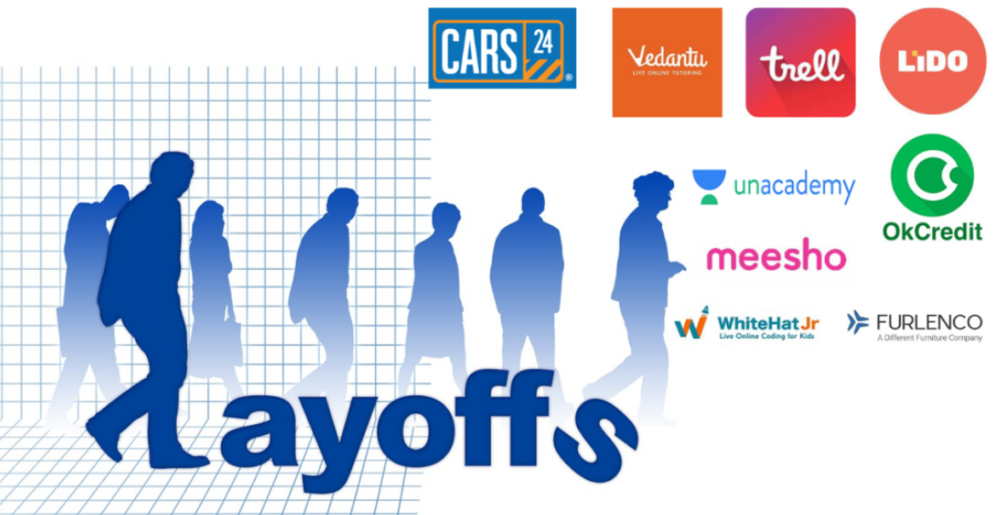

<div style="border-radius: 15px; padding: 10px; background-color: #0B1E47; border: 3px solid #ffffff; text-align: center;     box-shadow: 0px 2px 4px rgba(0, 0, 0, 0.2); border-radius:10px;
            border-style: solid;
            border-color: #36FF00;">
    <h1 style="color: #ffff00; text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 10px; font-size: 36px;">Tech Company Layoffs</h1>
</div>


<a id="table"></a>
<h1 style="background-color: #0B1E47; color: #ffffff; font-family: 'Times New Roman', serif; font-size: 2.5em; text-align: center; padding: 5px; border: 1px solid #ffffff; border-radius: 15px 12px;">About Dataset</h1>

#### The dataset covers tech company layoffs from 2020 to 2023, detailing key aspects of each event. It includes the company name, its headquarters location, and the date of the layoff announcement. The dataset specifies the industry sector, company stage (e.g., startup or growth), and the amount of funding raised in millions. It also provides data on the number of employees laid off, the total impacted workforce, and the percentage of the total workforce affected. This comprehensive overview allows for an in-depth analysis of trends, industry impacts, and the financial health of companies undergoing significant workforce reductions.

<p><strong>Company:</strong> The name of the tech company that is laying off employees.</p>
<p><strong>Location HQ:</strong> The headquarters of the company, which often influences economic and strategic decisions.</p>
<p><strong>Date:</strong> The specific date or range of dates when the layoffs were announced or occurred.</p>
<p><strong>Industry:</strong> The sector in which the company operates, providing context on market conditions that might influence layoffs.</p>
<p><strong>Stage:</strong> The company's current stage in its lifecycle, such as startup, growth, or mature, which can affect its vulnerability to economic pressures.</p>
<p><strong>$ Raised (mm):</strong> The amount of money the company has raised in millions, indicating its financial health and investment backing.</p>
<p><strong>Country:</strong> The country where the layoffs are happening, as regional economic conditions and regulations may impact the decision.</p>
<p><strong>Lay Off:</strong> The act of terminating employees, which can be due to various factors such as restructuring, cost-cutting, or shifts in business strategy.</p>
<p><strong>Impacted Workforce Percentage:</strong> The percentage of the total workforce affected by the layoffs, showing the scale of the impact on the company and its employees.</p>


<a id="1"></a>
<p style="padding: 10px; background-color: #0B1E47; color: #ffffff; font-family: 'Times New Roman', serif; font-size: 1.5em; text-align: center; border: 3px solid #ffffff; border-radius: 0px 0px; margin: 0; font-weight: 00;">IMPORTING LIBRARIES</p>


In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

<a id="2"></a>
<p style="padding: 10px; background-color: #0B1E47; color: #ffffff; font-family: 'Times New Roman', serif; font-size: 1.5em; text-align: center; border: 3px solid #ffffff; border-radius: 0px 0px; margin: 0; font-weight: 0;">LOADING DATASET</p>


In [2]:
df = pd.read_csv(r"E:\CodeBasic\tech_company_layoff_2.csv", encoding='latin1')
df.head()


,Company,Location HQ,Date,Industry,Stage,$ Raised (mm),Country,lay Off,Impacted workforce percentage
0,Bundle Africa,Lagos\r,7/21/2023,Crypto,Seed,1.0,Nigeria,0,1.00
1,Viaplay,Stockholm\r,7/20/2023,Media,Unknown,NaN,Sweden,450,0.25
2,Stoa,Phoenix,7/20/2023,Real Estate,Unknown,NaN,United States,80,0.80
3,Dunzo,Bengaluru\r,7/20/2023,Food,Unknown,382.0,India,0,0.00
4,MiQ,London\r,7/20/2023,Marketing,Private Equity,NaN,United Kingdom,0,0.00


In [3]:
df.shape

(2850, 9)

In [4]:
 df.shape[0]  # 0 - index 

2850

In [5]:
df.shape[1]  # 1-- index

9

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2850 entries, 0 to 2849
Data columns (total 9 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Company                        2850 non-null   object 
 1   Location HQ                    2850 non-null   object 
 2   Date                           2850 non-null   object 
 3   Industry                       2850 non-null   object 
 4   Stage                          2850 non-null   object 
 5   $ Raised (mm)                  2557 non-null   float64
 6   Country                        2850 non-null   object 
 7   lay Off                        2850 non-null   int64  
 8   Impacted workforce percentage  2850 non-null   float64
dtypes: float64(2), int64(1), object(6)
memory usage: 200.5+ KB


In [7]:
df.describe()

,$ Raised (mm),lay Off,Impacted workforce percentage
count,2557.000000,2850.000000,2850.000000
mean,794.298005,169.550877,0.174586
std,5204.979368,675.445845,0.250912
min,0.000000,0.000000,0.000000
25%,50.000000,0.000000,0.000000
50%,157.000000,40.000000,0.100000
75%,442.000000,110.000000,0.210000
max,121900.000000,12000.000000,1.000000


In [8]:
dict_counts={}
for i in df.columns:
    dict_counts[i]=df[i].value_counts().shape[0]
    
pd.DataFrame(dict_counts,index=['Unique']).T.style.background_gradient(cmap='bwr')

,Unique
Company,2188
Location HQ,223
Date,596
Industry,30
Stage,17
$ Raised (mm),637
Country,63
lay Off,314
Impacted workforce percentage,70


<a id="3"></a>
<p style="padding: 10px; background-color: #0B1E47; color: #ffffff; font-family: 'Times New Roman', serif; font-size: 1.5em; text-align: center; border: 3px solid #ffffff; border-radius: 5px px; margin: 0; font-weight: 500;">PREPROCESSING</p>


In [9]:
df.isnull().sum()

Company                            0
Location HQ                        0
Date                               0
Industry                           0
Stage                              0
$ Raised (mm)                    293
Country                            0
lay Off                            0
Impacted workforce percentage      0
dtype: int64

In [10]:
df.isnull().sum().sum()  #-- it show Total NULL value 

293

In [11]:
df.isnull().mean()*100         # OR --df.isnull().sum()/df.shape[0]*100   # shows percentage column wise NUll value

Company                           0.000000
Location HQ                       0.000000
Date                              0.000000
Industry                          0.000000
Stage                             0.000000
$ Raised (mm)                    10.280702
Country                           0.000000
lay Off                           0.000000
Impacted workforce percentage     0.000000
dtype: float64

In [12]:
df.isnull().mean().mean() * 100       #shows overall dataset me Total column  Null value percentage

1.142300194931774

In [13]:
df.notnull().sum()       # show Not NULL value 

Company                          2850
Location HQ                      2850
Date                             2850
Industry                         2850
Stage                            2850
$ Raised (mm)                    2557
Country                          2850
lay Off                          2850
Impacted workforce percentage    2850
dtype: int64

In [14]:
df.notnull().sum().sum()      # show Total Not NULL value 

25357

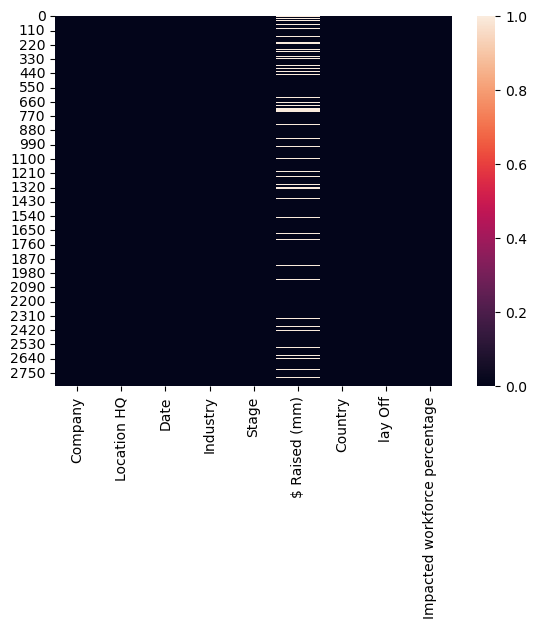

In [15]:
sns.heatmap(df.isnull())             
plt.show()

In [16]:
mean_value = df["$ Raised (mm)"].mean()
df["$ Raised (mm)"].fillna(mean_value, inplace=True)

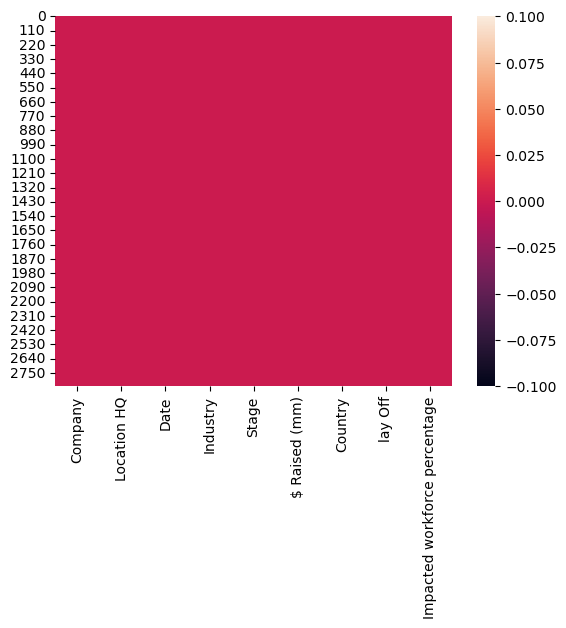

In [17]:
sns.heatmap(df.isnull())  
plt.show()

In [18]:
df.duplicated().sum()

1

In [19]:
df.drop_duplicates(inplace=True)

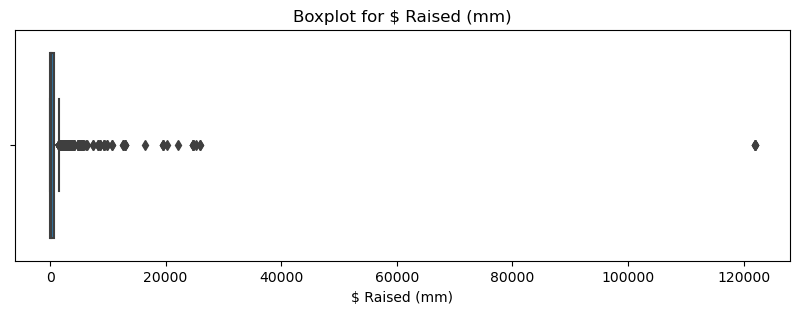

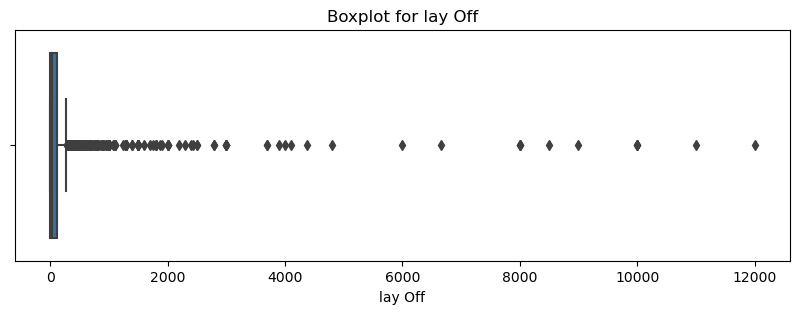

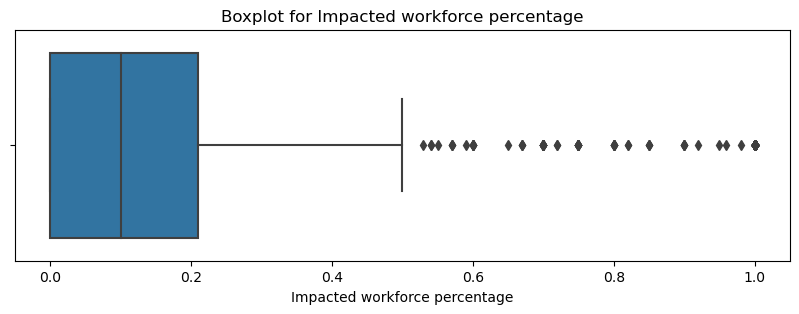

In [20]:
# Outlier find and Handle

numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns


for col in numeric_cols:
    plt.figure(figsize=(10, 3))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.xlabel(col)
    plt.show()

In [21]:
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

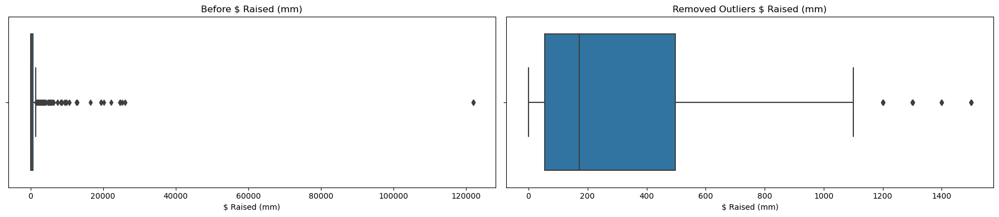

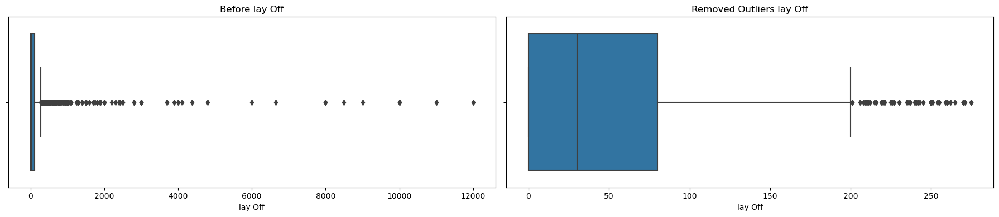

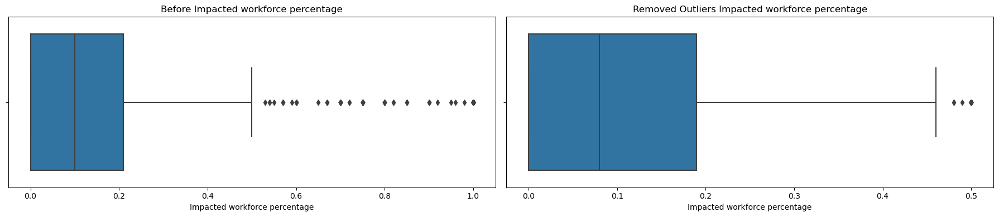

In [22]:
for col in numeric_cols:
    fig, axes = plt.subplots(1, 2, figsize=(18, 4), sharey=True)

   
    sns.boxplot(x=df[col], ax=axes[0])
    axes[0].set_title(f'Before {col}')
    axes[0].set_xlabel(col)

   
    df_no_outliers = remove_outliers(df, col)
    sns.boxplot(x=df_no_outliers[col], ax=axes[1])
    axes[1].set_title(f'Removed Outliers {col}')
    axes[1].set_xlabel(col)

    plt.tight_layout()
    plt.show()

<a id="3"></a>
<p style="padding: 10px; background-color: #0B1E47; color: #ffffff; font-family: 'Times New Roman', serif; font-size: 1.5em; text-align: center; border: 3px solid #ffffff; border-radius: 5px px; margin: 0; font-weight: 500;">EXPLORATORY  DATA  ANALYSIS</p>


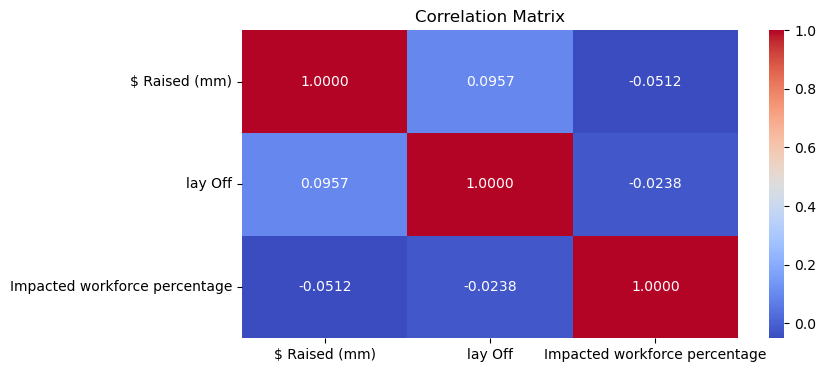

In [23]:

correlation_matrix = df[['$ Raised (mm)', 'lay Off', 'Impacted workforce percentage']].corr()


plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.4f')
plt.title('Correlation Matrix')
plt.show()


<div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The correlation matrix shows:
<ul>
  <li>The correlation between $ Raised (mm) and lay Off is 0.0957, indicating a slight positive relationship.</li>
  
 <li>The correlation between $ Raised (mm) and Impacted workforce percentage is -0.0512, indicating a very weak negative relationship.</li>
  <li>The correlation between lay Off and Impacted workforce percentage is -0.0238, showing a very weak negative relationship.</li>
</ul>
Overall, the correlations among the variables are weak.
</div>


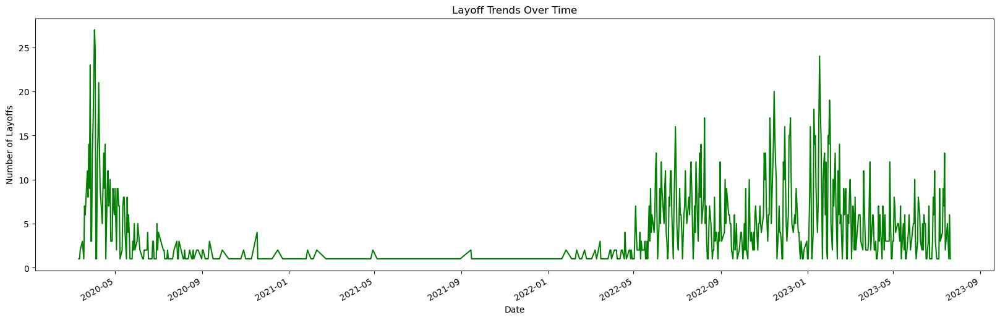

In [24]:

df['Date'] = pd.to_datetime(df['Date'], errors='coerce')


plt.figure(figsize=(20, 6))
df.groupby('Date').size().plot(kind='line',color='green')
plt.title('Layoff Trends Over Time')
plt.ylabel('Number of Layoffs')
plt.xlabel('Date')
plt.show()


<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Date</h2>
</div>


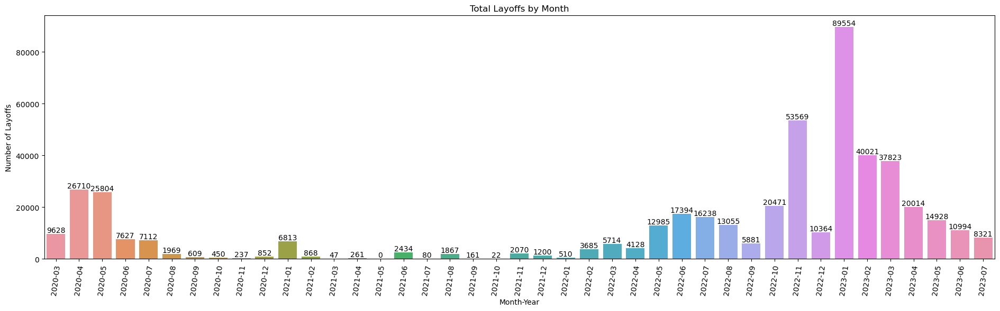

In [25]:
# Convert 'Date' to datetime
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')

# Extract month and year from 'Date'
df['Month-Year'] = df['Date'].dt.to_period('M')


monthly_layoffs = df.groupby('Month-Year')['lay Off'].sum()

plt.figure(figsize=(19, 6))


ax = sns.barplot(x=monthly_layoffs.index.astype(str), y=monthly_layoffs.values)
plt.title('Total Layoffs by Month')
plt.xlabel('Month-Year')
plt.ylabel('Number of Layoffs')
plt.xticks(rotation=83)  

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> From above graphs we can see that the highest layoffs occurred in January 2023 (89,554), the middle layoffs were observed in November 2022 (53,569), and the lowest layoffs happened in October 2021 (22).
</div>

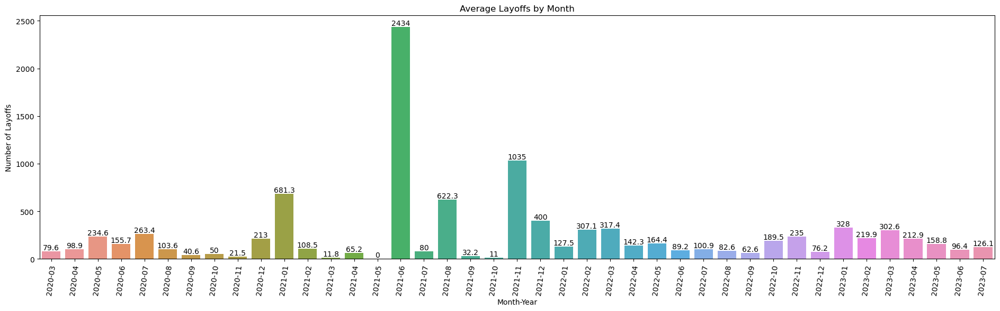

In [26]:

df['Month-Year'] = df['Date'].dt.to_period('M')


monthly_layoffs = df.groupby('Month-Year')['lay Off'].mean().round(1)

plt.figure(figsize=(19, 6))


ax = sns.barplot(x=monthly_layoffs.index.astype(str), y=monthly_layoffs.values)
plt.title('Average Layoffs by Month')
plt.xlabel('Month-Year')
plt.ylabel('Number of Layoffs')
plt.xticks(rotation=83)  

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The data shows that Average highest layoff rates were in June 2021 (2434.0), with significant rates in November 2021 (1035.0), and the lowest rates occurred in May 2021 (0.0).
</div>

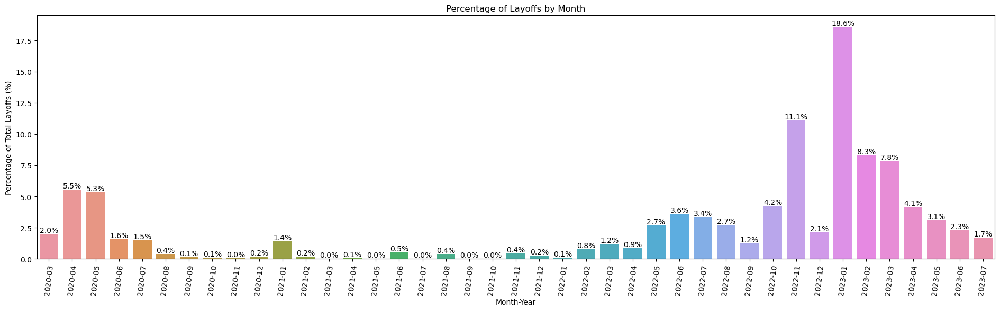

In [27]:

df['Month-Year'] = df['Date'].dt.to_period('M')

# Calculate total layoffs for each month
monthly_layoffs = df.groupby('Month-Year')['lay Off'].sum()


monthly_layoffs_percentage = (monthly_layoffs / monthly_layoffs.sum()) * 100


plt.figure(figsize=(19, 6))
ax = sns.barplot(x=monthly_layoffs_percentage.index.astype(str), y=monthly_layoffs_percentage.values)
plt.title('Percentage of Layoffs by Month')
plt.xlabel('Month-Year')
plt.ylabel('Percentage of Total Layoffs (%)')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The data indicates that the highest layoff percentages were in January 2023 (18.56%), followed by November 2022 (11.10%), and the lowest percentages were in March 2021 (0.01%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Country</h2>
</div>


In [28]:
Total_country=df['Country'].unique()
len(Total_country)

63

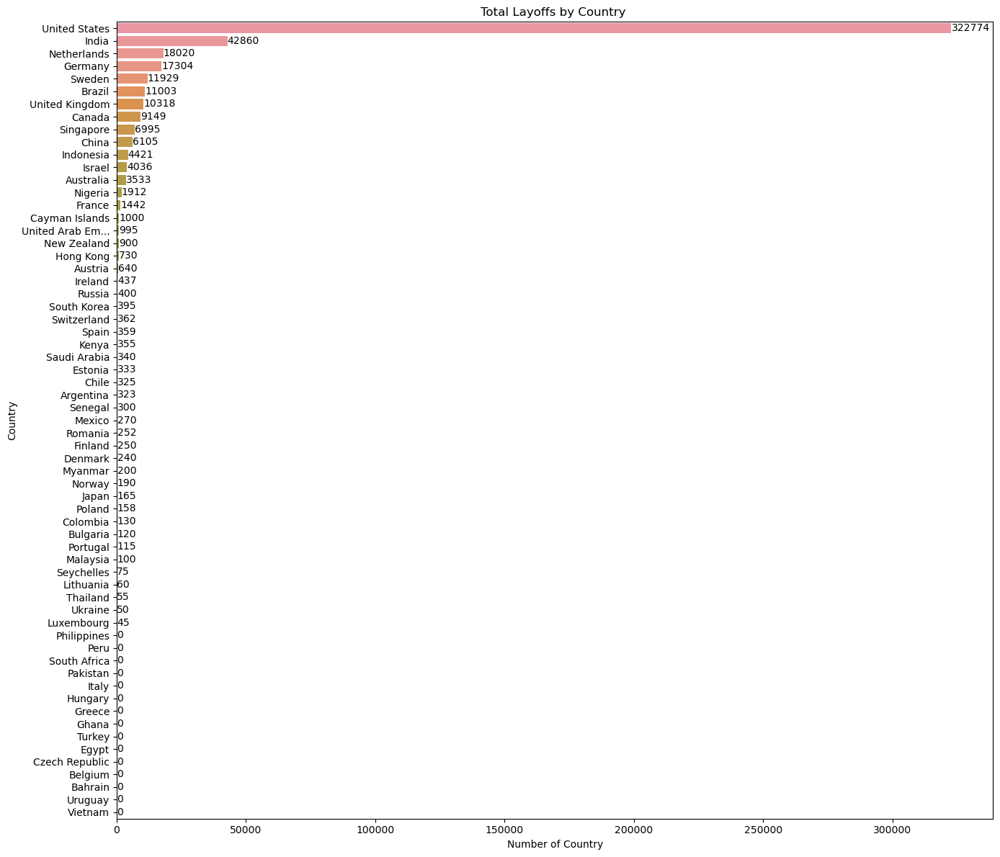

In [29]:
plt.figure(figsize=(14,12))
industry_layoffs = df.groupby('Country')['lay Off'].sum().sort_values(ascending=False)
ax=sns.barplot(x=industry_layoffs.values, y=industry_layoffs.head(63).index)
plt.title('Total Layoffs by Country ')
plt.xlabel('Number of Country')
plt.ylabel('Country')
#plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The data reveals that the United States had the highest total layoffs (3,22,774), followed by India (42,860), with Luxembourg recording the lowest total layoffs (45).
</div>

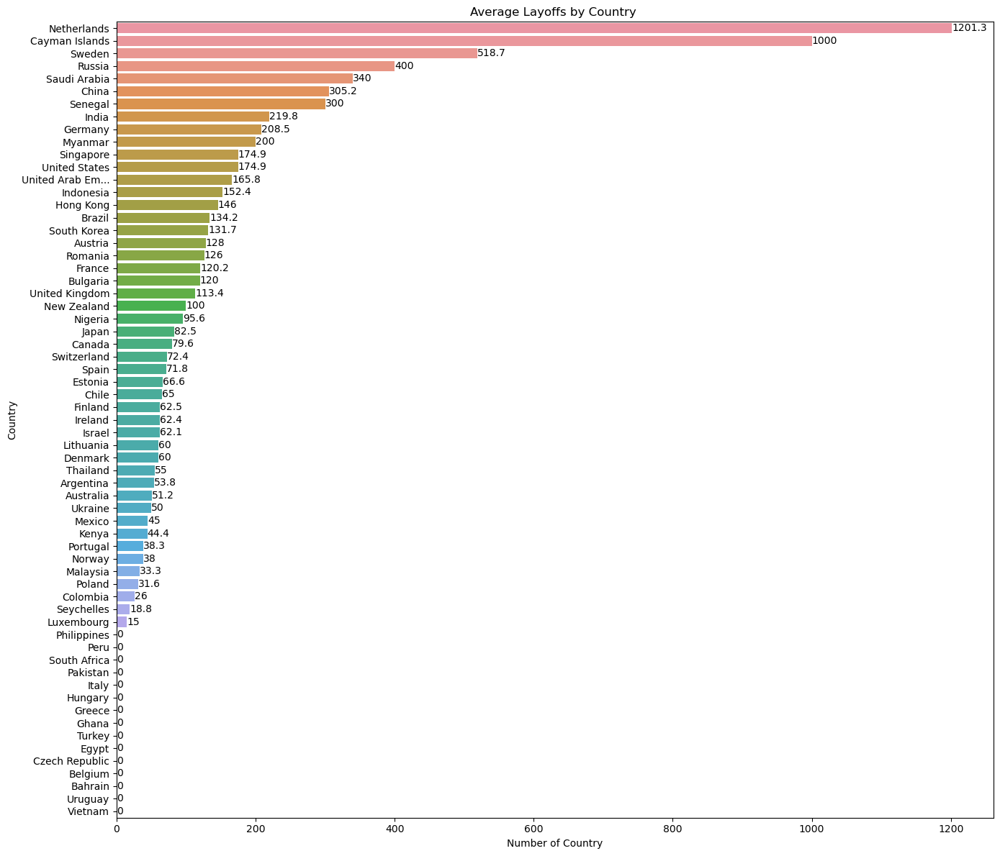

In [30]:
plt.figure(figsize=(14,12))
industry_layoffs = df.groupby('Country')['lay Off'].mean().sort_values(ascending=False).round(1)
ax=sns.barplot(x=industry_layoffs.values, y=industry_layoffs.head(63).index)
plt.title('Average Layoffs by Country ')
plt.xlabel('Number of Country')
plt.ylabel('Country')
#plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average layoffs by country indicate that the Netherlands had the highest average layoffs (1201.3), followed by the Cayman Islands (1000.0), with India at (219.8). Luxembourg had the lowest average layoffs at (15).
</div>

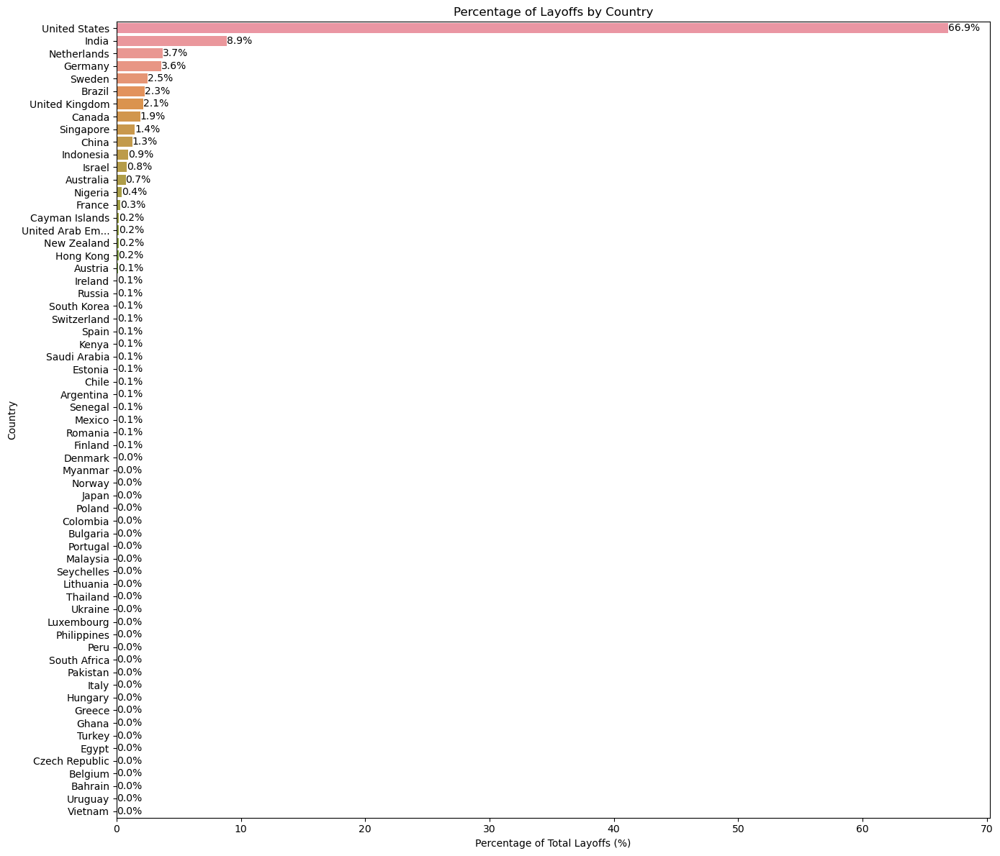

In [31]:
# Calculate total layoffs by country
country_layoffs = df.groupby('Country')['lay Off'].sum()


country_layoffs_percentage = (country_layoffs / country_layoffs.sum()) * 100


country_layoffs_percentage = country_layoffs_percentage.sort_values(ascending=False)


plt.figure(figsize=(14, 12))
ax = sns.barplot(x=country_layoffs_percentage.values, y=country_layoffs_percentage.index)
plt.title('Percentage of Layoffs by Country')
plt.xlabel('Percentage of Total Layoffs (%)')
plt.ylabel('Country')


for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of layoffs by country shows that the United States had the highest percentage of layoffs (66.9%), followed by India (8.8%), while Austria to Finland had a minimal percentage of (0.1%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;"> Industry</h2>
</div>


In [32]:
Total_Industry=df['Industry'].unique()
len(Total_Industry)

30

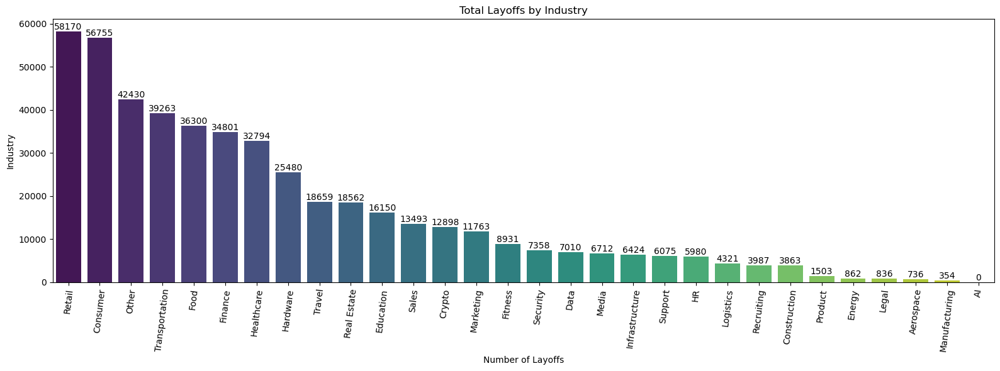

In [33]:
plt.figure(figsize=(16, 6))
industry_layoffs = df.groupby('Industry')['lay Off'].sum().sort_values(ascending=False)
ax=sns.barplot(x=industry_layoffs.index, y=industry_layoffs.values, palette='viridis')
plt.title('Total Layoffs by Industry')
plt.xlabel('Number of Layoffs')
plt.ylabel('Industry')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total layoffs by industry show that Retail had the highest number of layoffs (58,170), followed closely by Consumer (56,755). AI had no reported layoffs, while Manufacturing experienced the fewest layoffs (354).
</div>

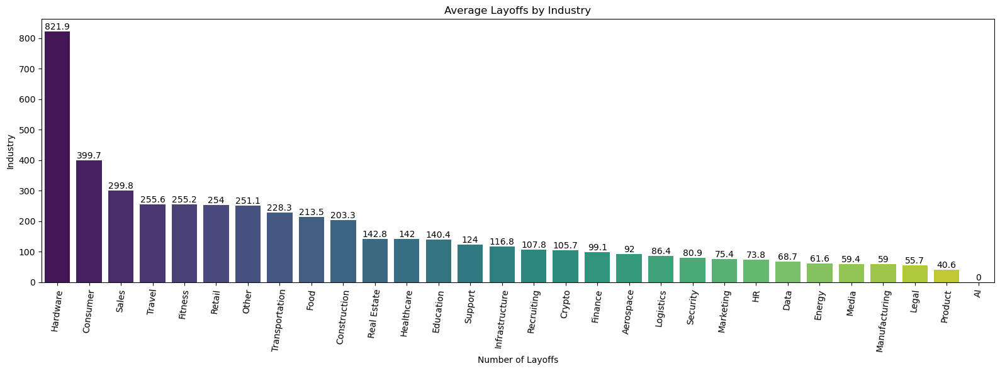

In [34]:
plt.figure(figsize=(16, 6))
industry_layoffs = df.groupby('Industry')['lay Off'].mean().sort_values(ascending=False).round(1)
ax=sns.barplot(x=industry_layoffs.index, y=industry_layoffs.values, palette='viridis')
plt.title('Average Layoffs by Industry')
plt.xlabel('Number of Layoffs')
plt.ylabel('Industry')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average layoffs by industry reveal that Hardware had the highest average layoffs (821.9), followed by Consumer (399.7) and Sales (299.8). The lowest averages were observed in Product (40.6) and AI (0.0).
</div>

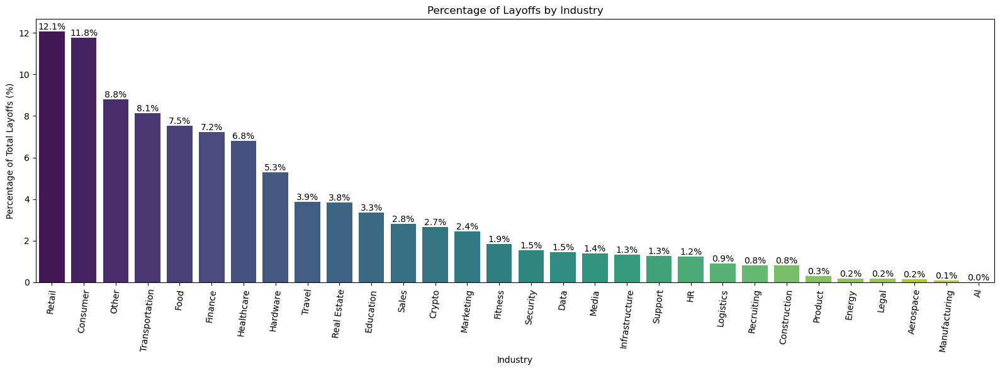

In [35]:

industry_layoffs = df.groupby('Industry')['lay Off'].sum()


industry_layoffs_percentage = (industry_layoffs / industry_layoffs.sum()) * 100


industry_layoffs_percentage = industry_layoffs_percentage.sort_values(ascending=False)


plt.figure(figsize=(16, 6))
ax = sns.barplot(x=industry_layoffs_percentage.index, y=industry_layoffs_percentage.values, palette='viridis')
plt.title('Percentage of Layoffs by Industry')
plt.xlabel('Industry')
plt.ylabel('Percentage of Total Layoffs (%)')
plt.xticks(rotation=83)


for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of layoffs by industry shows that Retail had the highest percentage of layoffs (12.06%), followed by Consumer (11.76%) and Other (8.79%). The industries with the lowest percentages were Manufacturing (0.07%) and AI (0.00%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Company</h2>
</div>


In [36]:
Company=df['Company'].unique()
len(Company)

2188

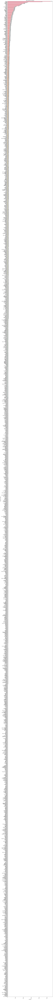

In [37]:
plt.figure(figsize=(14, 260))


industry_layoffs = df.groupby('Company')['lay Off'].sum().sort_values(ascending=False).head(2188)


ax = sns.barplot(x=industry_layoffs.values, y=industry_layoffs.index)
plt.title('Total Layoffs by Company')
plt.xlabel('Company')
plt.ylabel('Number of Layoffs')
plt.xticks(rotation=83)


for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total layoffs by company show that Amazon had the highest number of layoffs (27,230), followed by Meta (21,000) and Google (12,000). The least number of layoffs was reported by Spyce with just 4.
</div>

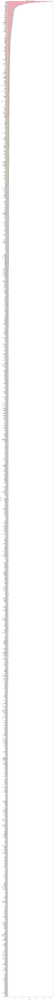

In [38]:
plt.figure(figsize=(14, 260))

industry_layoffs = df.groupby('Company')['lay Off'].mean().sort_values(ascending=False).head(2188).round(1)

ax = sns.barplot(x=industry_layoffs.values, y=industry_layoffs.index)
plt.title('Average Layoffs by Company')
plt.xlabel('Company')
plt.ylabel('Number of Layoffs')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average layoffs by company reveal that Google had the highest average layoffs (12,000), followed by Meta (10,500) and Ericsson (8,500). The lowest average was reported by Mara (3).
</div>

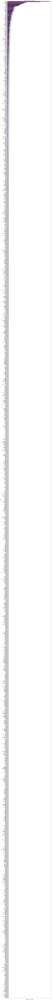

In [39]:
company_layoffs = df.groupby('Company')['lay Off'].sum()

company_layoffs_percentage = (company_layoffs / company_layoffs.sum()) * 100

top_companies = company_layoffs_percentage.sort_values(ascending=False)

plt.figure(figsize=(14, 265))
ax = sns.barplot(x=top_companies.values, y=top_companies.index, palette='viridis')
plt.title('Percentage of Layoffs by Company')
plt.xlabel('Percentage of Total Layoffs (%)')
plt.ylabel('Company')
plt.xticks(rotation=83)


for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of layoffs by company shows that Amazon had the highest percentage of layoffs (5.64%), followed by Meta (4.35%) and Google (2.49%). The lowest percentage was reported by F5 to ThredUp (0.1%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Stage</h2>
</div>


In [40]:
Stage=df['Stage'].unique()
len(Stage)

17

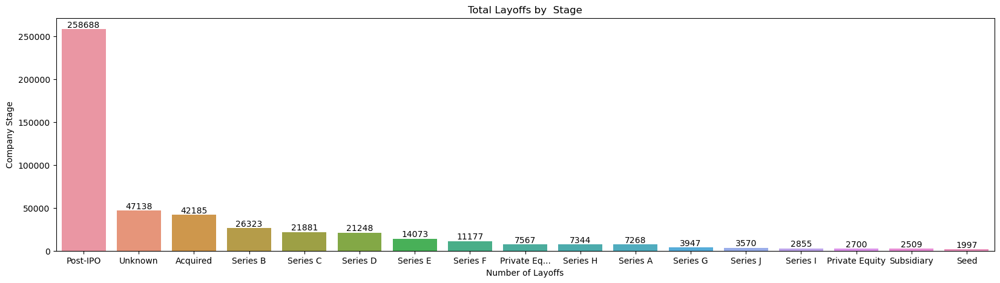

In [41]:
plt.figure(figsize=(20, 5))
stage_layoffs = df.groupby('Stage')['lay Off'].sum().sort_values(ascending=False)
ax=sns.barplot(x=stage_layoffs.index, y=stage_layoffs.values)
plt.title('Total Layoffs by  Stage')
plt.xlabel('Number of Layoffs')
plt.ylabel('Company Stage')

for bars in ax.containers:
    ax.bar_label(bars)
plt.show()

> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total layoffs by stage show that the highest number of layoffs occurred in the Post-IPO stage (2,58,688), followed by Unknown (47,138) and Acquired (42,185). The lowest numbers layoffs were observed in Seed (1,997).
</div>

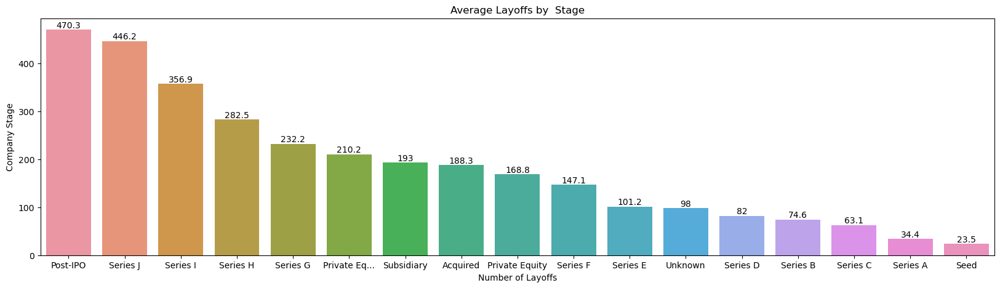

In [42]:
plt.figure(figsize=(20, 5))
stage_layoffs = df.groupby('Stage')['lay Off'].mean().sort_values(ascending=False).round(1)
ax=sns.barplot(x=stage_layoffs.index, y=stage_layoffs.values)
plt.title('Average Layoffs by  Stage')
plt.xlabel('Number of Layoffs')
plt.ylabel('Company Stage')

for bars in ax.containers:
    ax.bar_label(bars)
plt.show()

> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average layoffs by stage indicate that Post-IPO companies had the highest average layoffs (470.3), followed by Series J (446.2) and Series I (356.9). The lowest average layoffs were in Seed stage companies (23.5).
</div>

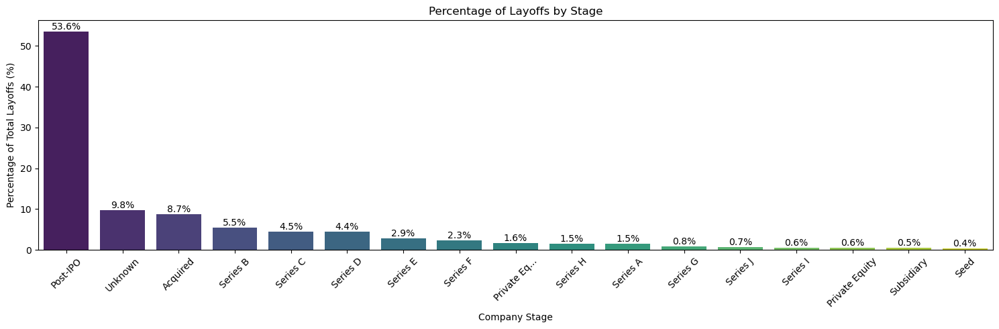

In [43]:
stage_layoffs = df.groupby('Stage')['lay Off'].sum()

stage_layoffs_percentage = (stage_layoffs / stage_layoffs.sum()) * 100

stage_layoffs_percentage = stage_layoffs_percentage.sort_values(ascending=False).round(1)


plt.figure(figsize=(15, 5))
ax = sns.barplot(x=stage_layoffs_percentage.index, y=stage_layoffs_percentage.values, palette='viridis')
plt.title('Percentage of Layoffs by Stage')
plt.xlabel('Company Stage')
plt.ylabel('Percentage of Total Layoffs (%)')

for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.xticks(rotation=45)  
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of layoffs by stage shows that Post-IPO companies had the highest percentage of layoffs (53.6%), followed by Unknown (9.8%) and Acquired (8.7%). The lowest percentages were reported in Seed stage (0.4%) and Subsidiary (0.5%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Location HQ</h2>
</div>


In [44]:
LocationHQ=df['Location HQ'].unique()
len(LocationHQ)

223

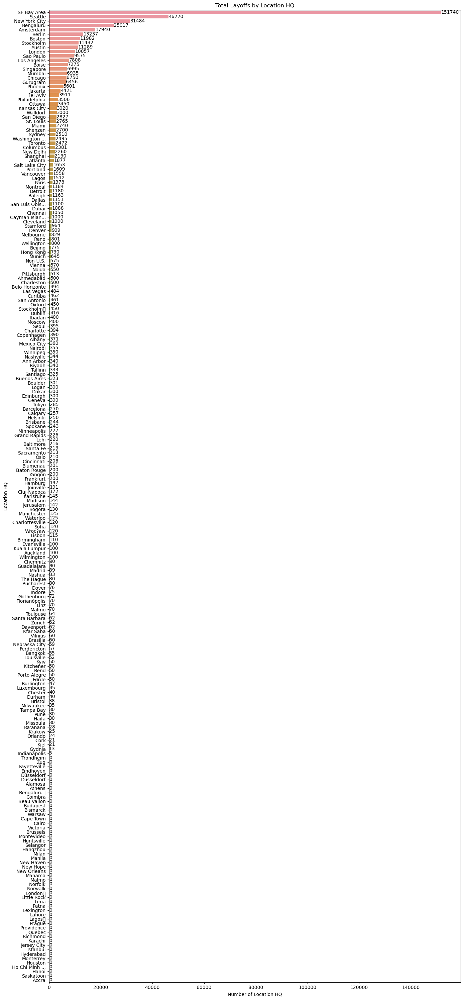

In [45]:
plt.figure(figsize=(14,30))
industry_layoffs = df.groupby('Location HQ')['lay Off'].sum().sort_values(ascending=False)
ax=sns.barplot(x=industry_layoffs.values, y=industry_layoffs.head(223).index)
plt.title('Total Layoffs by Location HQ')
plt.xlabel('Number of Location HQ')
plt.ylabel('Location HQ')
#plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total layoffs HQ by location show that the SF Bay Area experienced the highest number of layoffs (1,51,740), followed by Seattle (46,220) and New York City (31,484). The lowest number of layoffs was reported in Gdynia (13).
</div>

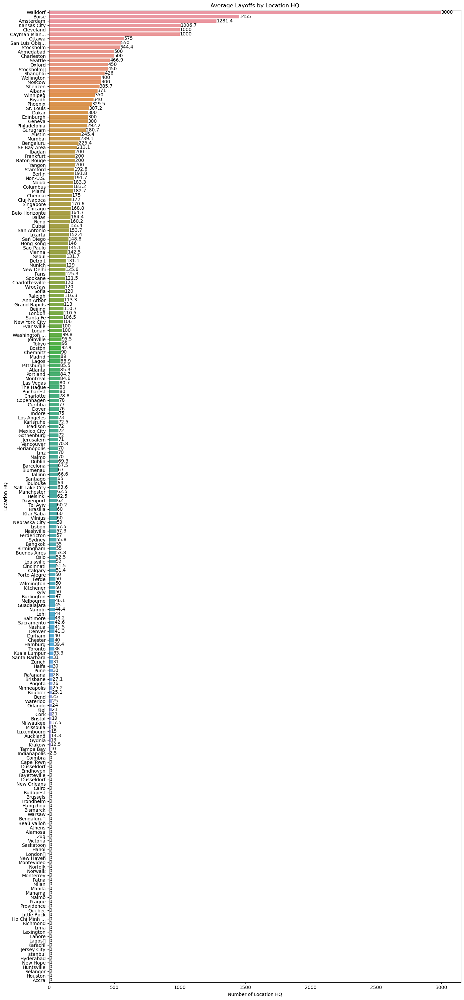

In [46]:
plt.figure(figsize=(14,30))
industry_layoffs = df.groupby('Location HQ')['lay Off'].mean().sort_values(ascending=False).round(1)
ax=sns.barplot(x=industry_layoffs.values, y=industry_layoffs.head(223).index)
plt.title('Average Layoffs by Location HQ')
plt.xlabel('Number of Location HQ')
plt.ylabel('Location HQ')
#plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average layoffs by location HQ show that Walldorf had the highest average layoffs (3,000.0), followed by Boise (1,455.0) and Amsterdam (1,281.4). The lowest average layoffs were reported in Indianapolis (2.5).
</div>

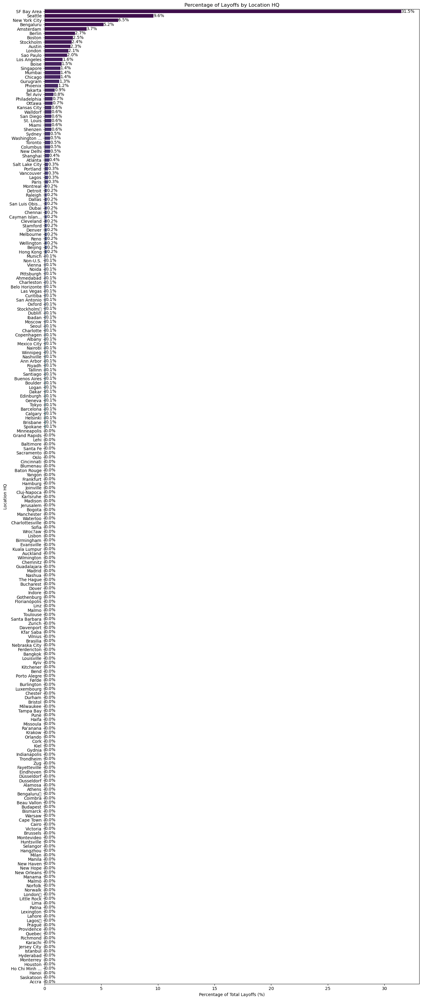

In [47]:
location_layoffs = df.groupby('Location HQ')['lay Off'].sum()

location_layoffs_percentage = (location_layoffs / location_layoffs.sum()) * 100

top_locations = location_layoffs_percentage.sort_values(ascending=False).round(1)


plt.figure(figsize=(14, 33))
ax = sns.barplot(x=top_locations.values, y=top_locations.index, palette='viridis')
plt.title('Percentage of Layoffs by Location HQ')
plt.xlabel('Percentage of Total Layoffs (%)')
plt.ylabel('Location HQ')


for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of layoffs by location HQ shows that the SF Bay Area had the highest percentage of layoffs (31.5%), followed by Seattle (9.6%) and New York City (6.5%). The lowest percentage was reported in Munich to Spokane (0.1%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Impacted Workforce Percentage</h2>
</div>


In [48]:
Impacted_workforce_percentage=df['Impacted workforce percentage'].unique()
len(Impacted_workforce_percentage)

70

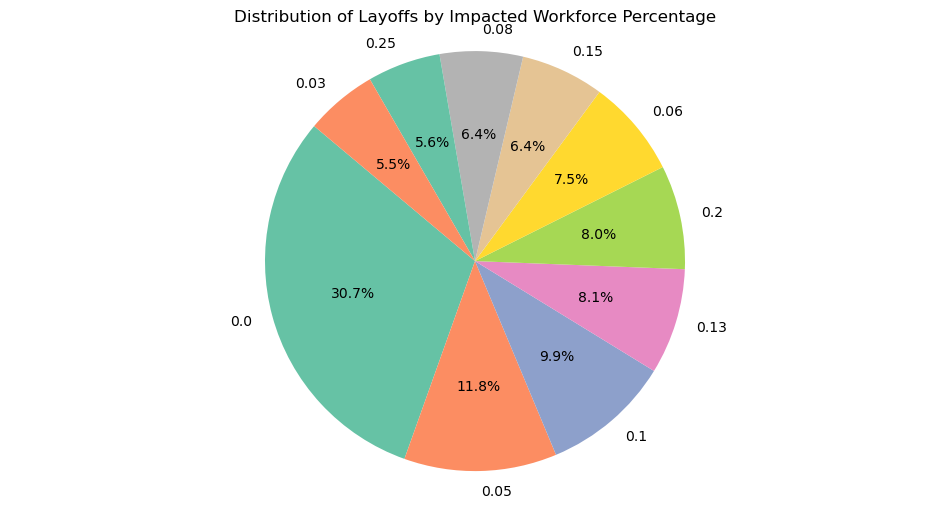

In [49]:
percentage_layoffs = df.groupby('Impacted workforce percentage')['lay Off'].sum().sort_values(ascending=False)


top_percentages = percentage_layoffs.head(10)


plt.figure(figsize=(12, 6))
plt.pie(top_percentages, labels=top_percentages.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('Set2', len(top_percentages)))
plt.title('Distribution of Layoffs by Impacted Workforce Percentage')
plt.axis('equal')  
plt.show()


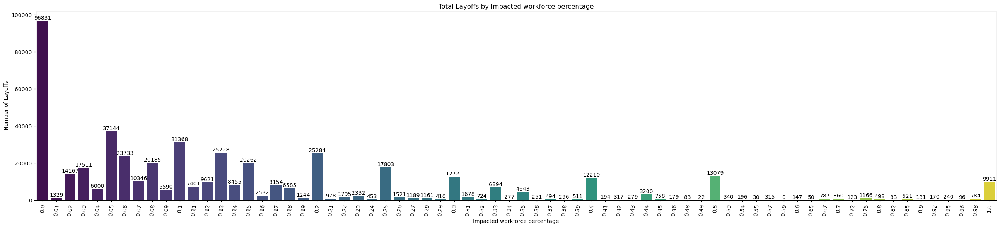

In [50]:
plt.figure(figsize=(26, 6))
industry_layoffs = df.groupby('Impacted workforce percentage')['lay Off'].sum().sort_values(ascending=False)
ax=sns.barplot(x=industry_layoffs.index, y=industry_layoffs.values, palette='viridis')
plt.title('Total Layoffs by Impacted workforce percentage')
plt.xlabel('Impacted workforce percentage')
plt.ylabel(' Number of Layoffs')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The impacted workforce percentage data shows that the majority of layoffs had an impact of 0.00% (96,831), followed by 0.05% (37,144) and 0.10% (31,368). The least impact was observed at 0.49% (22).
</div>

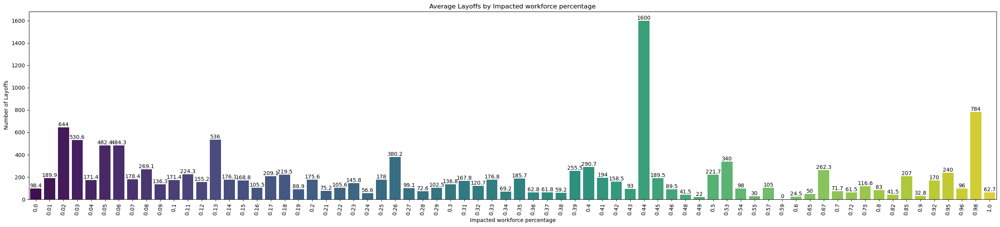

In [51]:
plt.figure(figsize=(26, 6))
industry_layoffs = df.groupby('Impacted workforce percentage')['lay Off'].mean().sort_values(ascending=False).round(1)
ax=sns.barplot(x=industry_layoffs.index, y=industry_layoffs.values, palette='viridis')
plt.title('Average Layoffs by Impacted workforce percentage')
plt.xlabel('Impacted workforce percentage')
plt.ylabel(' Number of Layoffs')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)
plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The average impacted workforce data shows that the highest average impacted workforce was at 0.44 (1,600), followed by 0.98 (784) and 0.02 (644). The lowest averages were observed at 0.59 (0).
</div>

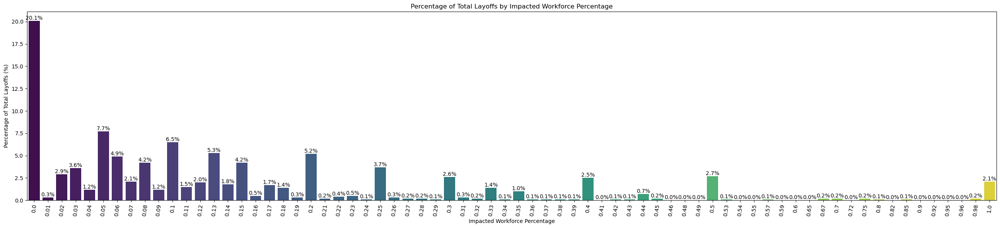

In [52]:
workforce_layoffs = df.groupby('Impacted workforce percentage')['lay Off'].sum()

workforce_layoffs_percentage = (workforce_layoffs / workforce_layoffs.sum()) * 100

sorted_workforce_layoffs_percentage = workforce_layoffs_percentage.sort_values(ascending=False).round(1)

plt.figure(figsize=(26, 6))
ax = sns.barplot(x=sorted_workforce_layoffs_percentage.index, y=sorted_workforce_layoffs_percentage.values, palette='viridis')
plt.title('Percentage of Total Layoffs by Impacted Workforce Percentage')
plt.xlabel('Impacted Workforce Percentage')
plt.ylabel('Percentage of Total Layoffs (%)')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars, fmt='%.1f%%')

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The percentage of impacted workforce shows that the highest percentage was at 0.00 (20.1%), followed by 0.05 (7.7%) and 0.10 (6.5%). The lowest percentage was reported at 0.52 (0.1%).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">$ Raised (mm)</h2>
</div>


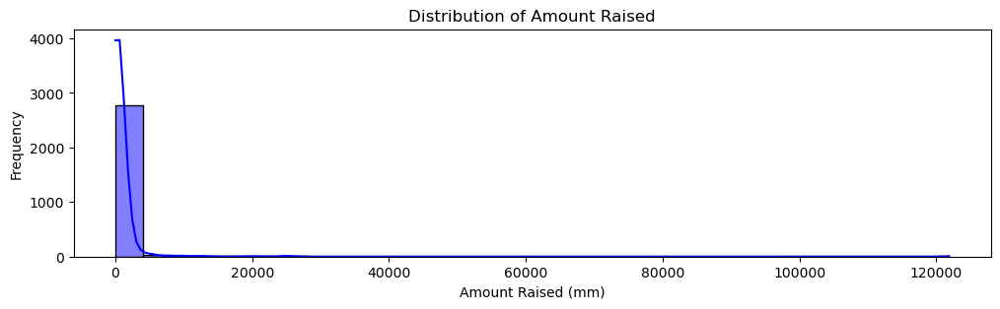

In [53]:
plt.figure(figsize=(12, 3))
sns.histplot(df['$ Raised (mm)'], bins=30, kde=True, color='blue')
plt.title('Distribution of Amount Raised')
plt.xlabel('Amount Raised (mm)')
plt.ylabel('Frequency')
plt.show()


In [54]:
Impacted_workforce_percentage=df['$ Raised (mm)'].unique()
len(Impacted_workforce_percentage)

638

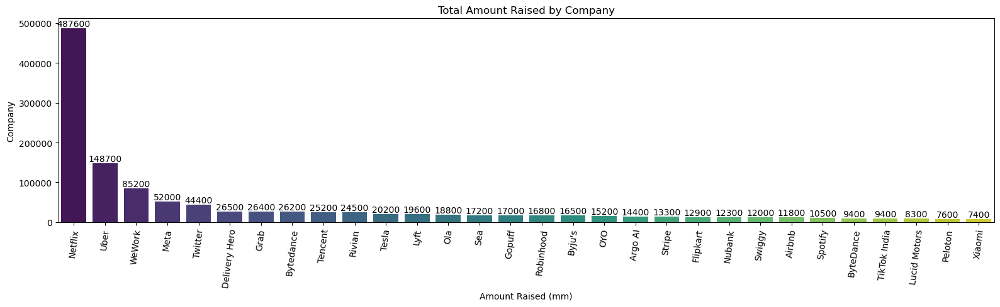

In [55]:
plt.figure(figsize=(16, 5))

company_funding = df.groupby('Company')['$ Raised (mm)'].sum().sort_values(ascending=False).head(30)

ax = sns.barplot(x=company_funding.index, y=company_funding.values, palette='viridis')

plt.title('Total Amount Raised by Company')
plt.xlabel('Amount Raised (mm)')
plt.ylabel('Company')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b>The total amount $ raised by companies shows that Netflix raised the highest amount (4,87,600), followed by Uber (1,48,700) and WeWork (85,200). The lowest amount raised was by Purse to TextNow (1).
</div>

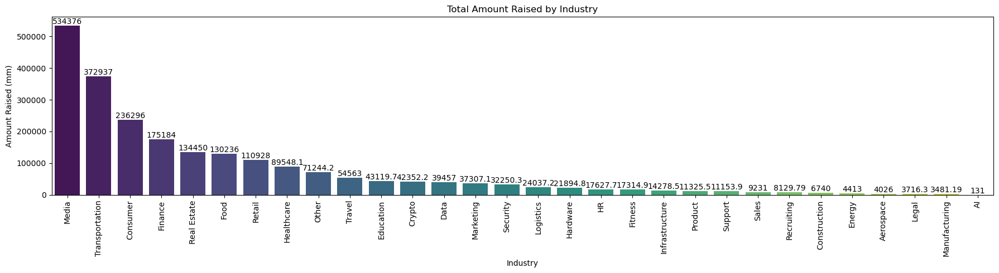

In [56]:
plt.figure(figsize=(18, 5))
industry_funding = df.groupby('Industry')['$ Raised (mm)'].sum().sort_values(ascending=False)
ax = sns.barplot(x=industry_funding.index, y=industry_funding.values, palette='viridis')
plt.title('Total Amount Raised by Industry')
plt.xlabel('Industry')
plt.ylabel('Amount Raised (mm)')
plt.xticks(rotation=90)

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total amount $ raised by industry shows that Media raised the highest amount (5,34,375), followed by Transportation (3,72,936) and Consumer (2,36,296). The least amount raised was in AI (131).
</div>

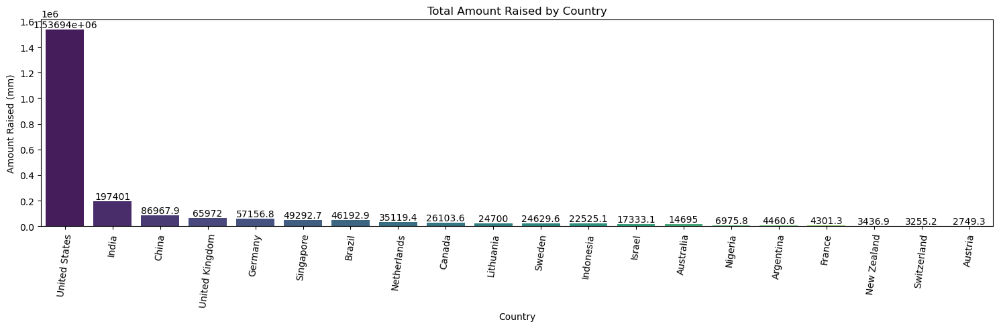

In [57]:
plt.figure(figsize=(15, 5))

country_funding = df.groupby('Country')['$ Raised (mm)'].sum().sort_values(ascending=False).head(20).round(1)

ax = sns.barplot(x=country_funding.index, y=country_funding.values, palette='viridis')


plt.title('Total Amount Raised by Country')
plt.xlabel('Country')
plt.ylabel('Amount Raised (mm)')
plt.xticks(rotation=83)

for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout()  
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total amount $ raised by country shows that the United States raised the highest amount (15,36,944), followed by India (1,97,400) and China (86,967). The lowest amount raised was in Uruguay (2).
</div>

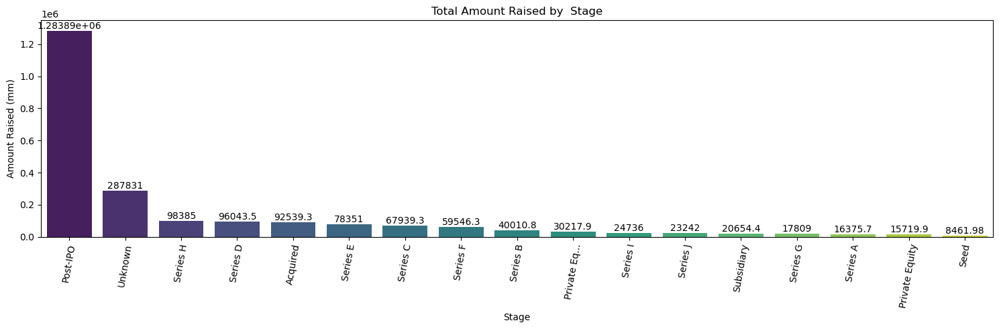

In [58]:

plt.figure(figsize=(15, 5))

# Group by 'Stage' and sum the '$ Raised (mm)' column
stage_funding = df.groupby('Stage')['$ Raised (mm)'].sum().sort_values(ascending=False)

ax = sns.barplot(x=stage_funding.index, y=stage_funding.values, palette='viridis')

plt.title('Total Amount Raised by  Stage')
plt.xlabel('Stage')
plt.ylabel('Amount Raised (mm)')
plt.xticks(rotation=80)


for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout() 
plt.show()

> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total amount $ raised by stage shows that Post-IPO stages raised the highest amount (1,283,886), followed by Unknown (287,830) and Series H (98,385). The lowest amount raised was in Seed (8,462).
</div>

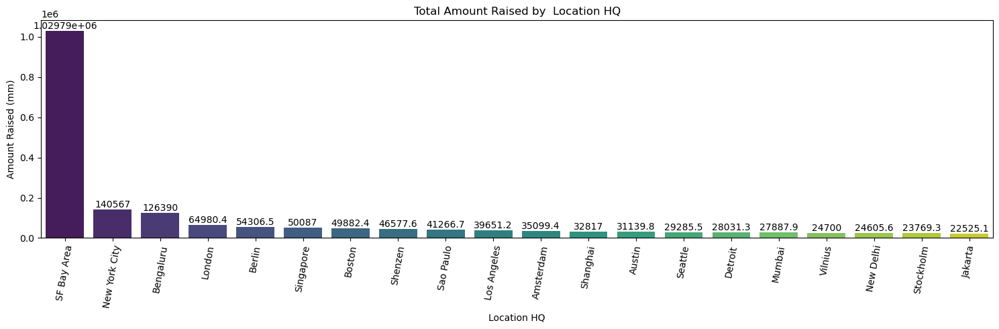

In [59]:
plt.figure(figsize=(15, 5))

# Group by 'Location HQ' and sum the '$ Raised (mm)' column
location_funding = df.groupby('Location HQ')['$ Raised (mm)'].sum().sort_values(ascending=False).head(20)

ax = sns.barplot(x=location_funding.index, y=location_funding.values, palette='viridis')

plt.title('Total Amount Raised by  Location HQ')
plt.xlabel('Location HQ')
plt.ylabel('Amount Raised (mm)')
plt.xticks(rotation=80)


for bars in ax.containers:
    ax.bar_label(bars)

plt.tight_layout() 
plt.show()


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b>INFO:</b> The total amount $ raised by location shows that the SF Bay Area leads with (10,29,792), followed by New York City (140,567), Bengaluru (126,390), and London (64,980). The lowest amount raised among the listed locations is in Lagos\r (1).
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Conclusion</h2>
</div>


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b></b> The layoff analysis reveals that the SF Bay Area and Post-IPO stages experienced the highest impact, with Amazon and Google leading in layoffs. The highest percentages were observed in the Retail and Hardware industries, while significant layoffs were noted in high-growth stages like Series J and Post-IPO. Countries like the United States faced the highest layoff percentages, highlighting a strong correlation between company stage, location, and industry.
</div>

<div style="border-radius: 15px 0 15px 0px; border: 1px solid #ffffff; padding: 5px; background-color: #0B1E47; text-align: center; box-shadow: 0px 1px 2px rgba(0, 0, 0, 0.2);">
    <h2 style="color: #ffff00; text-shadow: 1px 1px 2px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 3px; font-size: 18px;">Project Learning</h2>
</div>


> <div class="alert alert-block alert-success" style="color:darkgreen;">
<b></b>  Understanding the patterns of layoffs reveals key trends that can help predict future workforce impacts and identify at-risk industries. It provides valuable insights into how layoffs are influenced by company stage, location, and industry. This knowledge enables companies to make informed strategic decisions and implement proactive measures to mitigate potential risks. Additionally, it highlights the need for targeted support and planning in high-impact sectors to better manage workforce changes.
</div>

<div style="border-radius: 15px; padding: 10px; background-color: #0B1E47; border: 3px solid #ffffff; text-align: center;     box-shadow: 0px 2px 4px rgba(0, 0, 0, 0.2); border-radius:10px;
            border-style: solid;
            border-color: #36FF00;">
    <h1 style="color: #ffff00; text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.5); font-weight: bold; margin-bottom: 10px; font-size: 36px;">Thank you !</h1>
</div>
